# similarity test

In [2]:
import os
import joblib
import matplotlib.pyplot as plt
import numpy as np
import cv2
from tqdm import tqdm
from PIL import Image
from PIL import ImageFilter
import torch.utils.data as data
import torch
import pcl.builder
import pcl.loader
import torchvision.transforms as transforms
data_dir = '/home/user/data/parkingmap/img'
data_list = [os.path.join(data_dir, x) for x in os.listdir(data_dir)]
data_list = np.sort(data_list)

In [3]:
data_list

array(['/home/user/data/parkingmap/img/1682005850962740646.png',
       '/home/user/data/parkingmap/img/1682005851062331328.png',
       '/home/user/data/parkingmap/img/1682005851158418576.png', ...,
       '/home/user/data/parkingmap/img/1682006000855483879.png',
       '/home/user/data/parkingmap/img/1682006000955587816.png',
       '/home/user/data/parkingmap/img/1682006001054908422.png'],
      dtype='<U54')

In [4]:
img = cv2.imread(data_list[0])

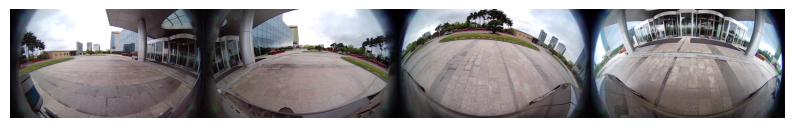

In [5]:
plt.figure(figsize=(10, 8)) 
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis("off")
plt.show()

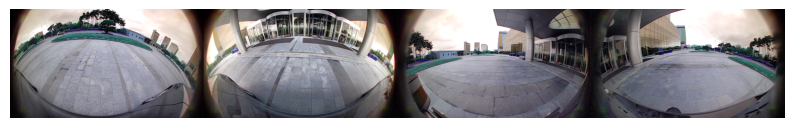

In [6]:
img_size = int(img.shape[1] / 4)
data_patches = np.stack([img[:, i * img_size:(i + 1) * img_size] for i in range(4)])
index_list = np.arange(0, 4).tolist()
random_cut = np.random.randint(4)
index_list = index_list[random_cut:] + index_list[:random_cut]
permuted_patches = data_patches[index_list]
augmented_img = np.concatenate(np.split(permuted_patches, 4, axis=0), 2)[0]
plt.figure(figsize=(10, 8)) 
augmented_img = cv2.cvtColor(augmented_img, cv2.COLOR_BGR2RGB)
plt.imshow(augmented_img)
plt.axis("off")
plt.show()

In [7]:
class ParkingImageEvalDataset(data.Dataset):
    def __init__(self, data_list, base_transform=None, resize_factor=1):
        self.data_list = data_list
        self.base_transform = base_transform
        self.resize_factor = resize_factor

    def __getitem__(self, index):
        return self.pull_image(index)

    def __len__(self):
        return len(self.data_list)

    def correct_order(self, img):
        img_size = int(img.shape[1] / 4)
        data_patches = np.stack([img[:, i * img_size:(i + 1) * img_size] for i in range(4)])
        permuted_patches = data_patches[[0, 2, 1, 3]]
        img = np.concatenate(np.split(permuted_patches, 4, axis=0), 2)[0]
        return img

    def pull_image(self, index):
        x = cv2.imread(self.data_list[index])
        x = cv2.resize(x, (0, 0), fx=self.resize_factor, fy=self.resize_factor)
        x = self.correct_order(x)
        if self.base_transform is not None:
            q = self.base_transform(Image.fromarray((x[..., :3]).astype(np.uint8)))
        else:
            q = torch.tensor(x[..., :3]).permute(2, 0, 1)
        return q, index


In [8]:

normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406],
                                     std=[0.229, 0.224, 0.225])
eval_augmentation = transforms.Compose([
        transforms.ToTensor(),
        normalize
    ])
eval_dataset = ParkingImageEvalDataset(
        data_list,
        eval_augmentation,
        0.1
    )
eval_loader = torch.utils.data.DataLoader(
        eval_dataset, batch_size=1, shuffle=False,
        sampler=None, num_workers=0, pin_memory=True)

In [9]:
import torchvision.models as models
low_dim = 128
model = pcl.builder.MoCo(
            models.__dict__['resnet50'],
            low_dim, 64, 0.999, 0.2, True)
checkpoint = torch.load("/home/user/codes/PCL/experiment_pcl/checkpoint_0199.pth.tar")
state_dict = checkpoint['state_dict']
for k in list(state_dict.keys()):
    # retain only encoder_q up to before the embedding layer
    if k.startswith('module.'):# and not k.startswith('module.encoder_q.fc'):
        # remove prefix
        state_dict[k[len("module."):]] = state_dict[k]
    # delete renamed or unused k
    del state_dict[k]
model.load_state_dict(state_dict, strict=False)
model.eval()
model = model.cuda()

In [10]:
features = torch.zeros(len(eval_loader.dataset), 128).cuda()
for i, (images, index) in enumerate(tqdm(eval_loader)):
    with torch.no_grad():
        images = images.cuda(non_blocking=True)
        feat = model(images, is_eval=True)
        features[index] = feat

  0%|                                                                                                                                                                                                                                          | 0/1502 [00:00<?, ?it/s]/home/user/anaconda3/envs/distdepth/lib/python3.8/site-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /tmp/pip-req-build-pma2oi4d/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1502/1502 [06:01<00:00,  4.16it/s]


In [11]:
features = features.cpu().detach().numpy()

0.075969286


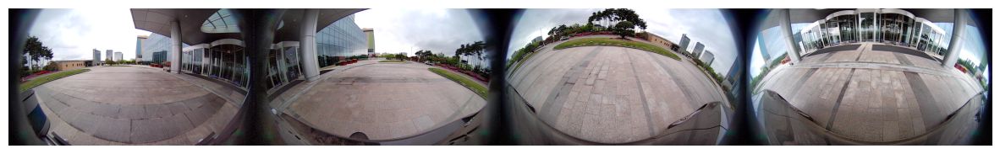

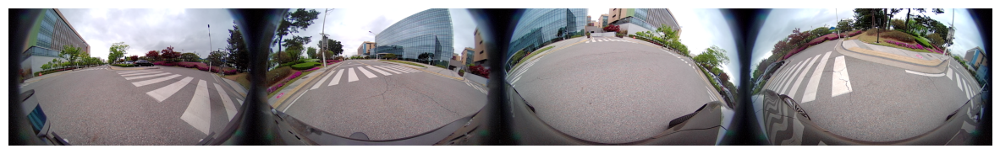

In [15]:
from sklearn.metrics.pairwise import cosine_similarity
import numpy as np

idx1 = 0
idx2 = 400
# Convert the lists to numpy arrays
array1 = np.array(features[idx1]).reshape(1, -1)
array2 = np.array(features[idx2]).reshape(1, -1)

# Calculate the cosine similarity
similarity = cosine_similarity(array1, array2)[0][0]
print(similarity)

plt.figure(figsize=(15, 15)) 
img = cv2.imread(data_list[idx1])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis("off")
plt.show()
plt.figure(figsize=(15, 15)) 
img = cv2.imread(data_list[idx2])
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
plt.imshow(img)
plt.axis("off")
plt.show()

16


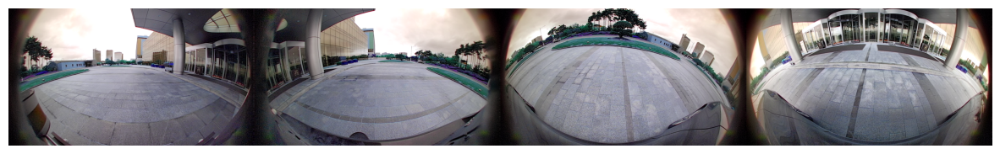

55


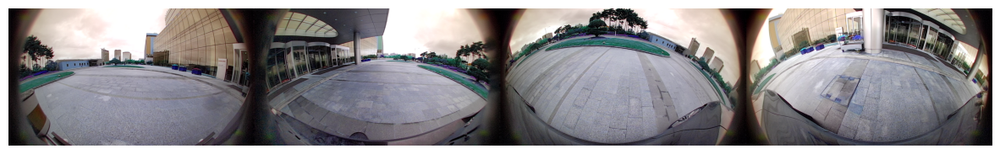

67


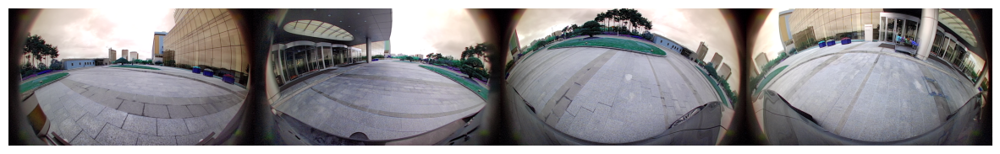

91


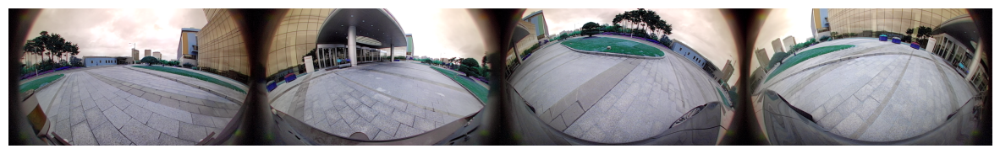

128


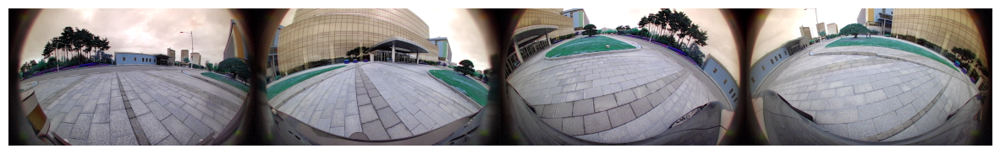

176


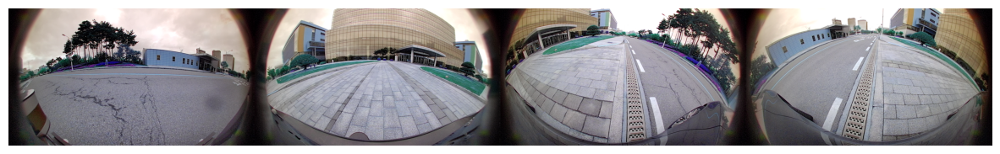

192


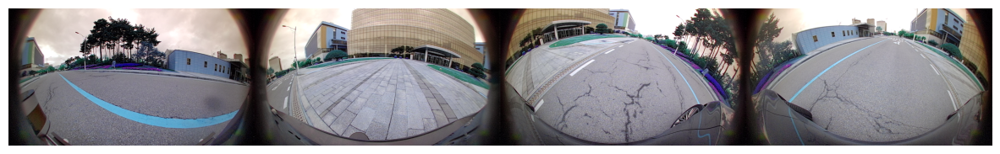

221


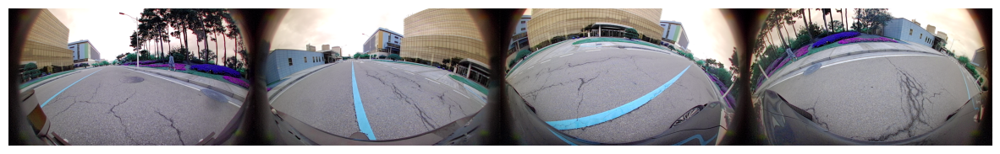

227


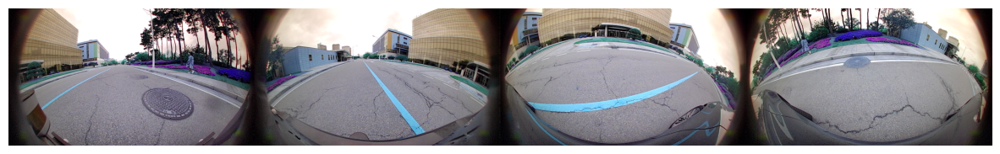

233


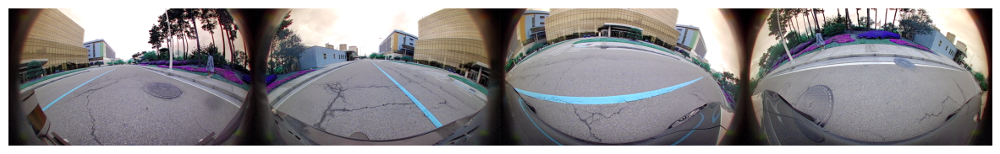

253


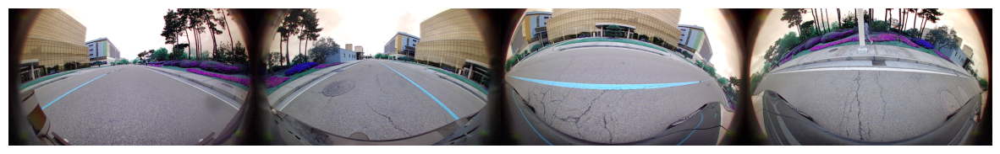

277


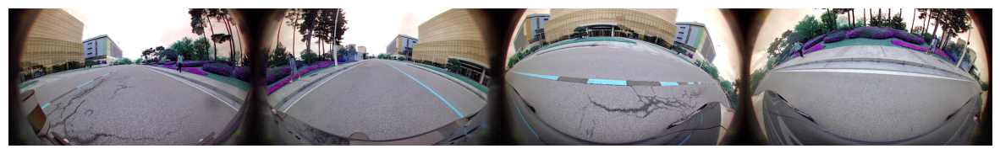

298


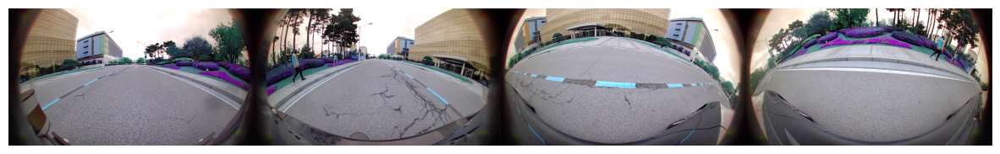

333


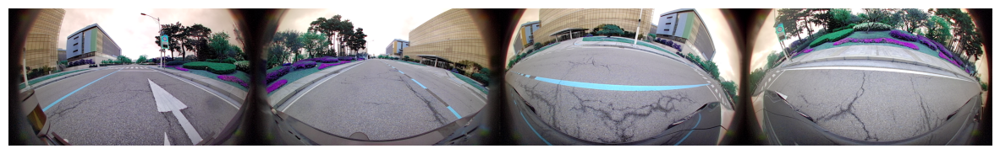

341


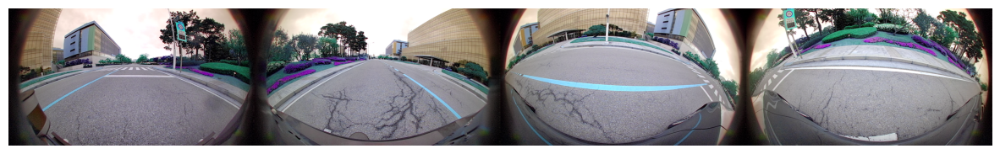

385


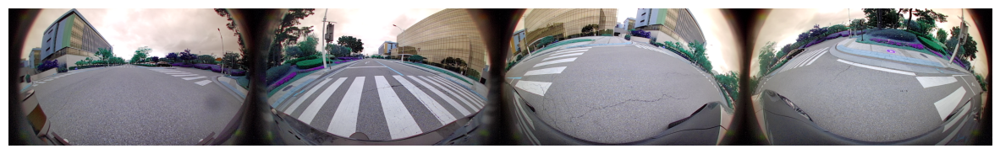

402


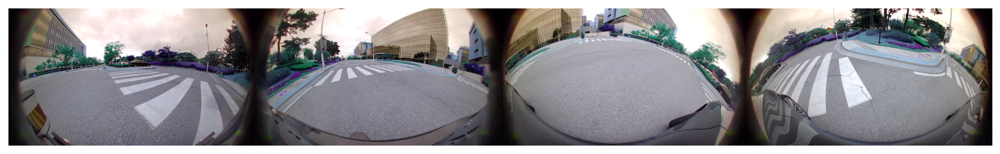

430


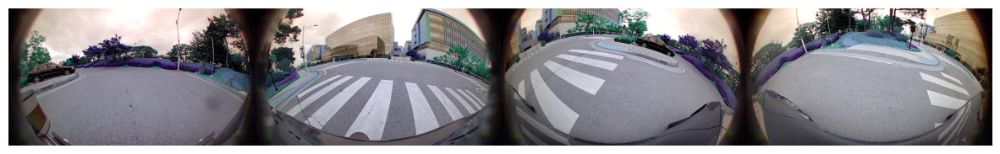

444


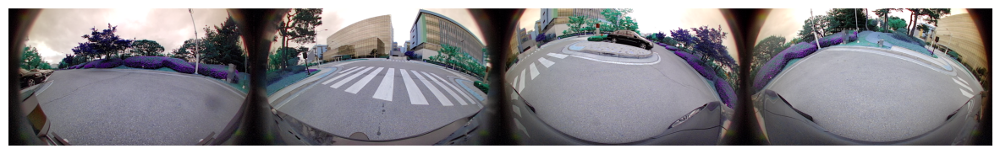

493


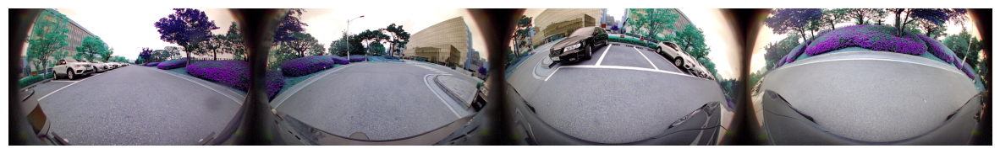

558


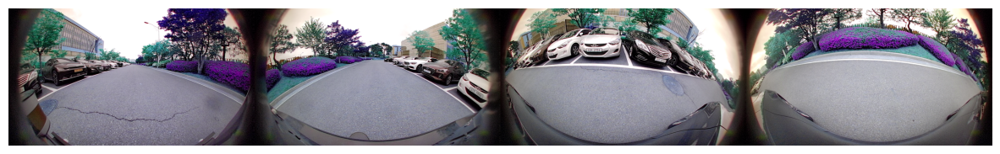

581


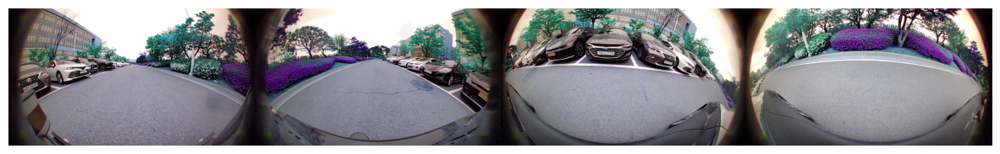

594


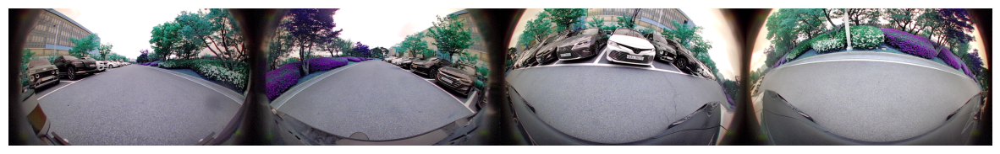

613


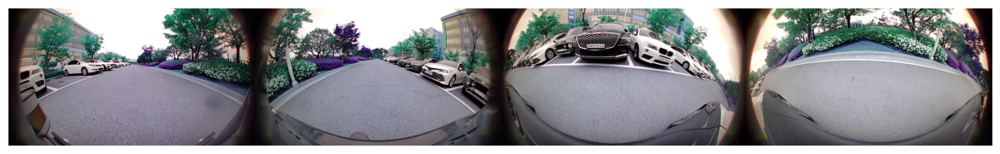

644


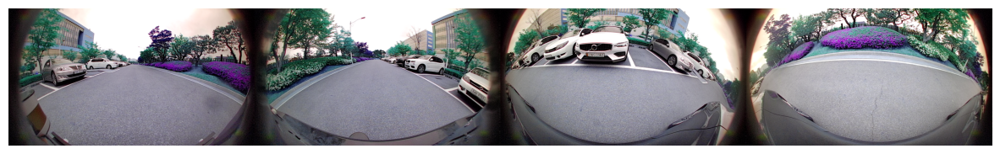

657


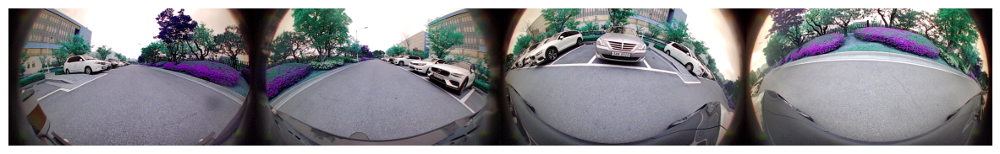

673


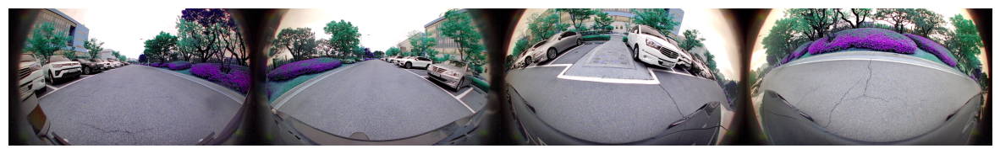

685


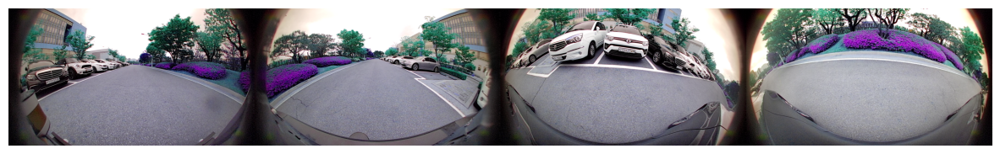

693


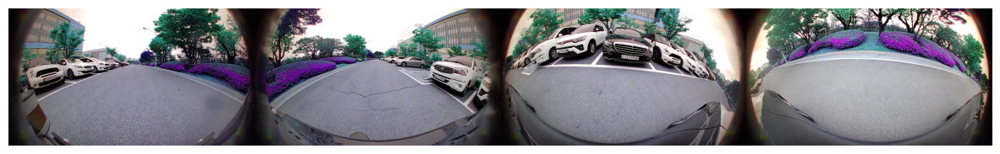

775


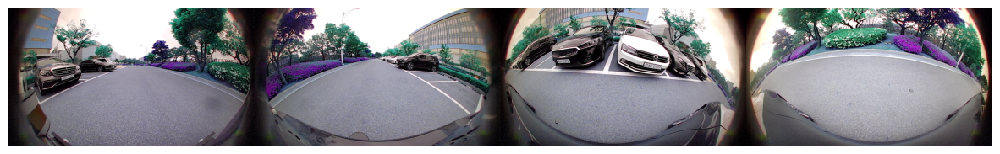

832


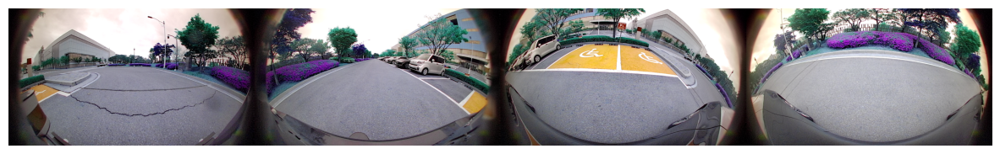

873


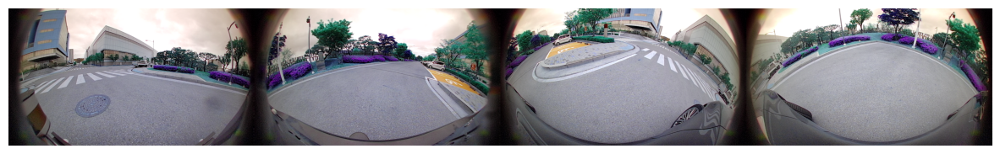

889


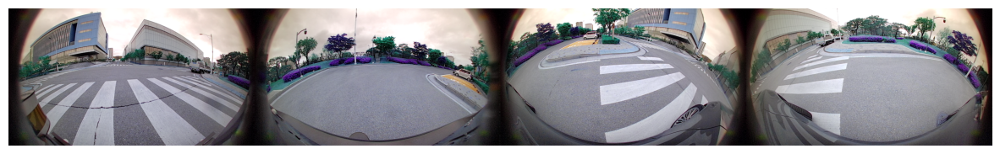

901


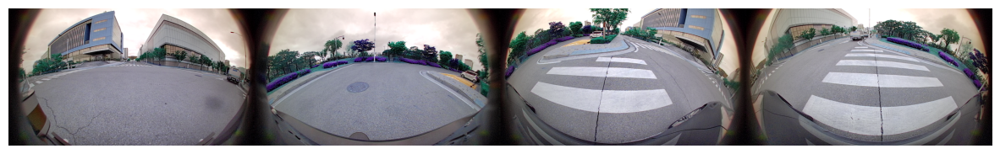

915


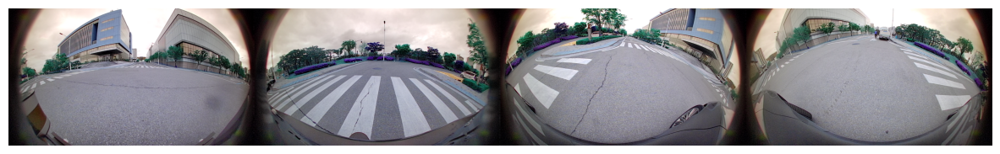

948


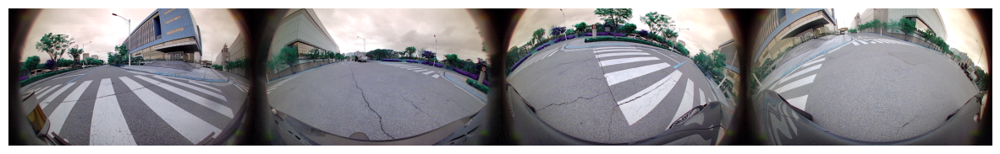

964


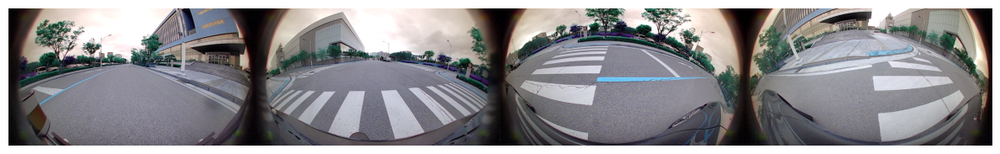

977


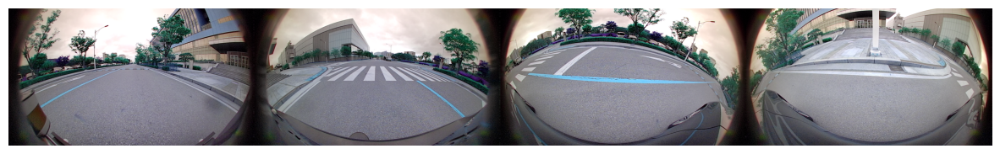

1015


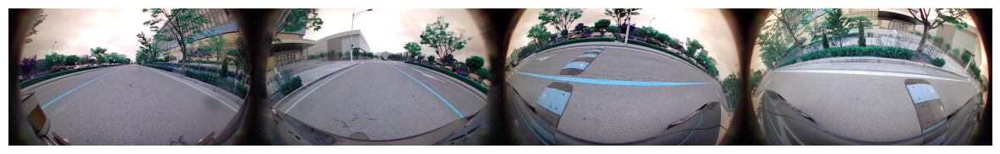

1041


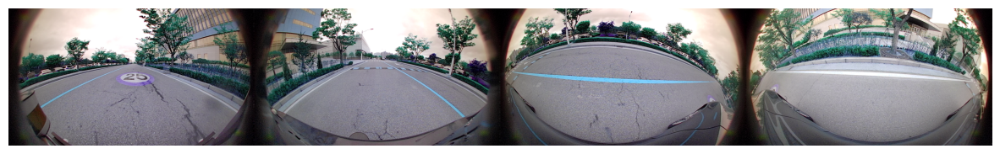

1047


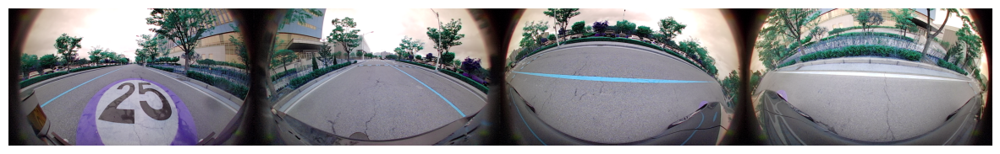

1120


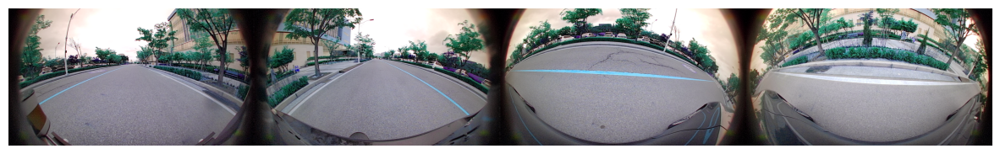

1147


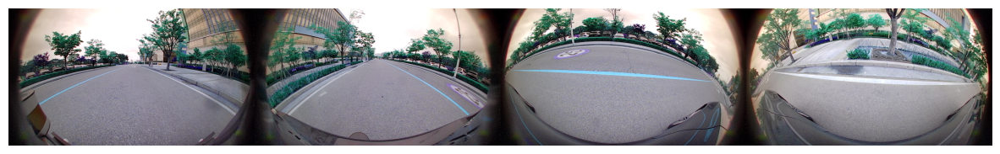

1168


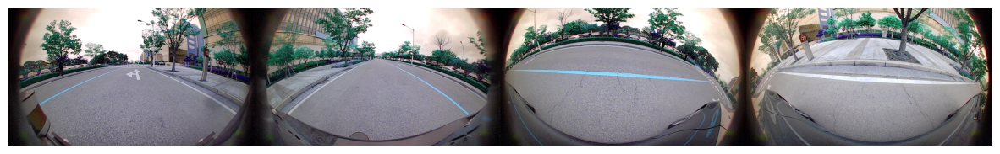

1178


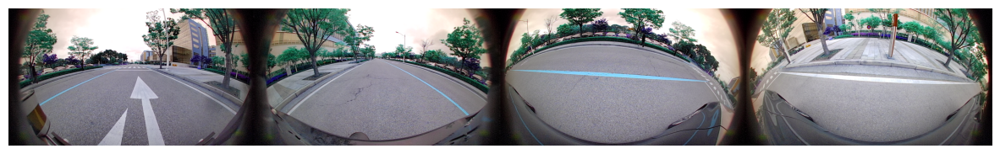

1184


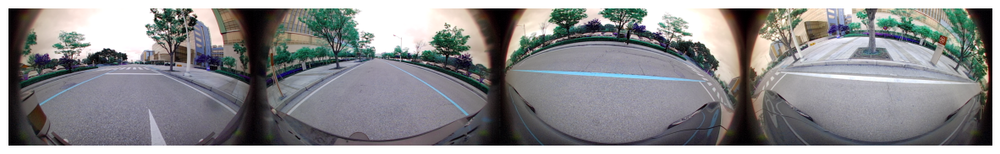

1206


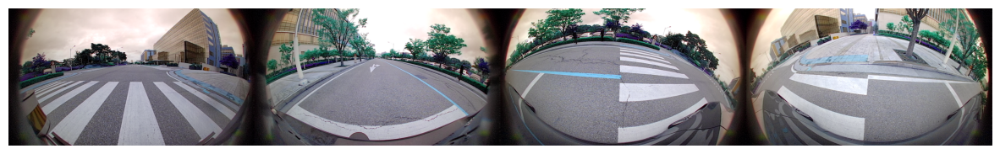

1242


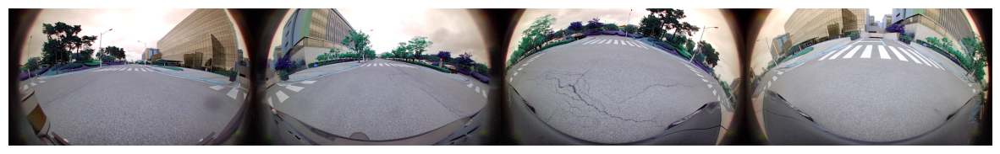

1255


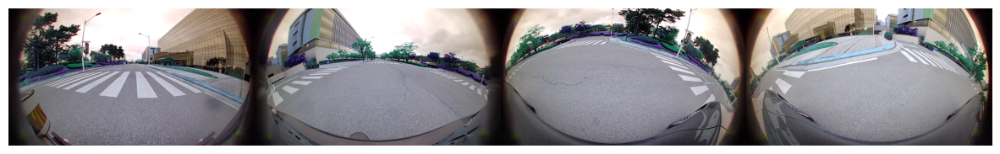

1264


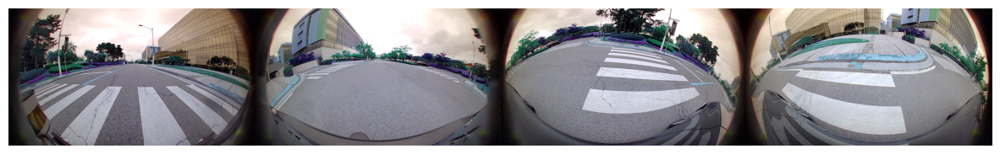

1274


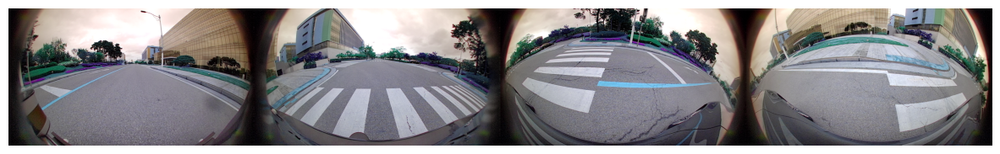

1290


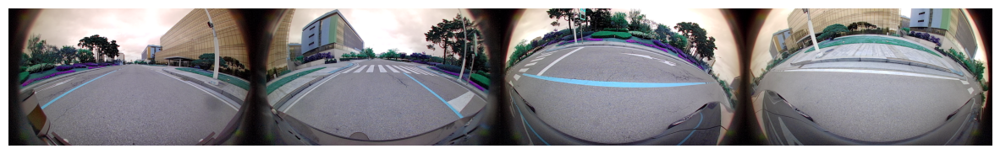

1324


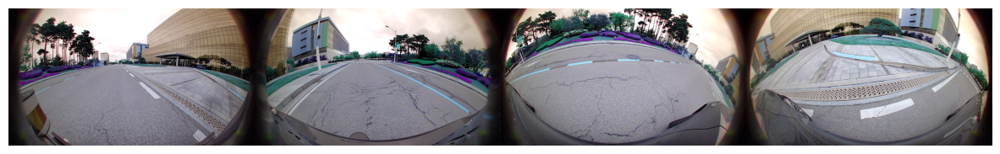

1338


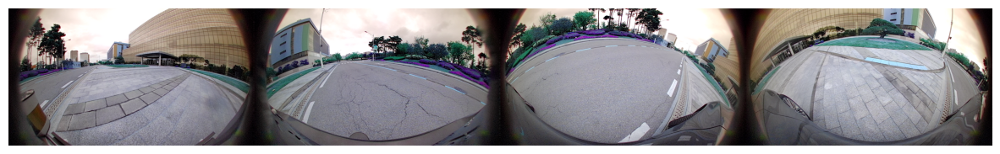

1344


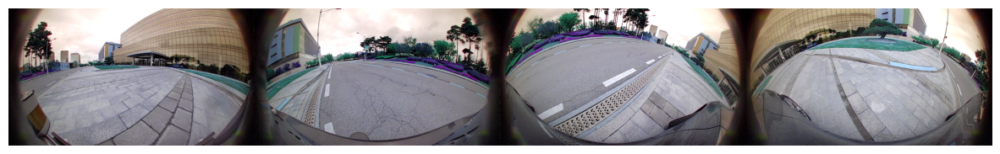

1358


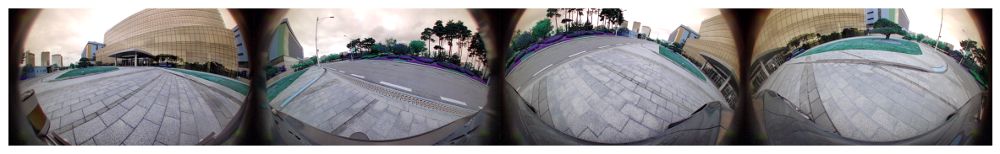

1383


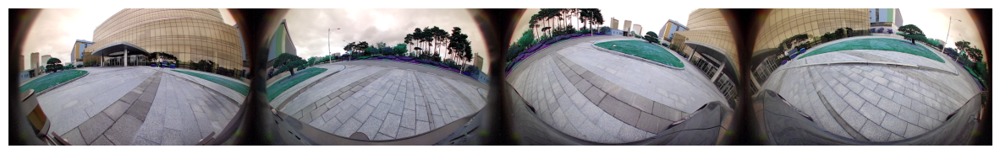

1407


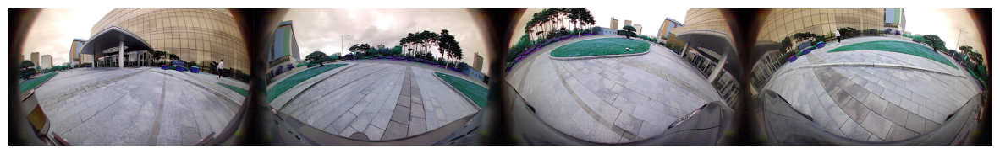

1452


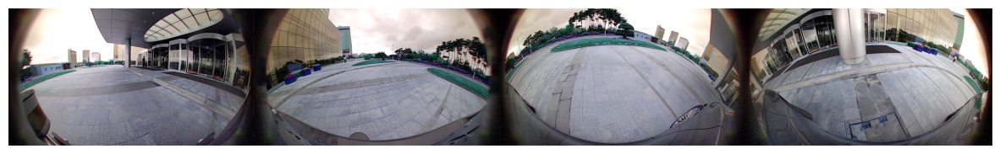

1460


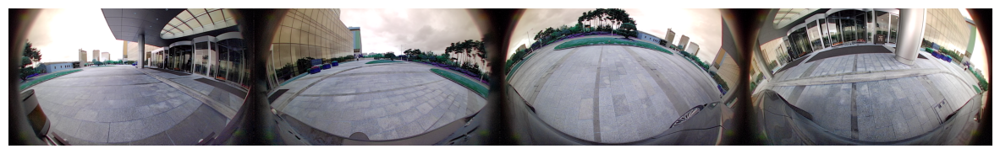

1469


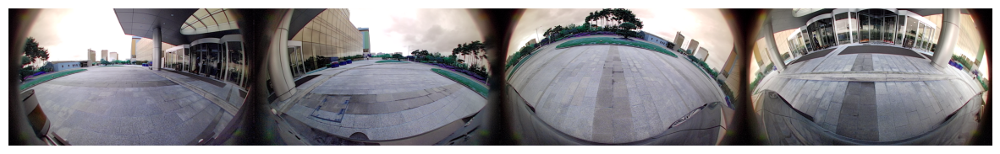

1487


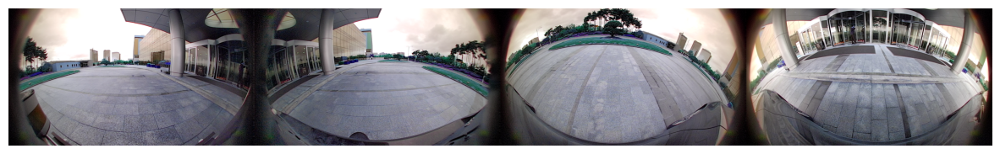

In [21]:
thresh = 0.8
prev_node_feat = np.array(features[0]).reshape(1, -1)
for i, data_path in enumerate(data_list):
    feat = np.array(features[i]).reshape(1, -1)
    similarity = cosine_similarity(prev_node_feat, feat)[0][0]
    if similarity < thresh:
        prev_node_feat = feat
        print(i)
#         plt.figure(figsize=(15,15))
#         img = cv2.imread(data_path)
#         plt.imshow(img)
#         plt.axis("off")
#         plt.show()